#**Advanced topics in Deep Learning**

#**Name and ID:**
Tal Teri: 319123543

Yehuda Daniel: 211789680

Chen Shalev: 313584906

Ilan Brilovich: 322525072

Lin Tibi: 318232139


#Kaggle Monet-cycleGan

Imports

In [ ]:
import os, re, logging, warnings, functools, json
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import random

from tensorflow import GradientTape

import keras
from keras.models import Sequential
from keras.layers import (Dense, Conv2D, BatchNormalization, Dropout, Flatten, LeakyReLU,ReLU,
                          Input, Conv2DTranspose, Concatenate, GroupNormalization, GaussianNoise, ZeroPadding2D)
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from keras.preprocessing.image import ImageDataGenerator
import cv2

Checking for TPU

In [ ]:
#Configuring TPU
try:
  resolver = tf.distribute.cluster_resolver.TPUClusterResolver()
except ValueError:
  print("TPU not found. Using default strategy (may be slower).")
  resolver = None

if resolver:
  tf.config.experimental_connect_to_cluster(resolver)
  tf.tpu.experimental.initialize_tpu_system(resolver)
  strategy = tf.distribute.TPUStrategy(resolver)
else:
  strategy = tf.distribute.get_strategy()

Installing Kaggle

In [ ]:
#Installing kaggle
!pip install kaggle

In [ ]:
# Your Kaggle credentials
kaggle_credentials = {
    "username": "ilanbrilovitch",
    "key": "0f1ee3dac62e187e2b0fbd8290e20b79"
}

# Create the Kaggle directory if it doesn't exist
kaggle_dir = os.path.expanduser("~/.kaggle")
os.makedirs(kaggle_dir, exist_ok=True)

# Write the Kaggle credentials to the kaggle.json file
kaggle_json_path = os.path.join(kaggle_dir, "kaggle.json")
with open(kaggle_json_path, "w") as kaggle_file:
    json.dump(kaggle_credentials, kaggle_file)

# Set the appropriate permissions
os.chmod(kaggle_json_path, 0o600)

print("Kaggle credentials set successfully!")


Kaggle credentials set successfully!


In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


!kaggle competitions download -c gan-getting-started
!unzip gan-getting-started.zip

Streaming output truncated to the last 5000 lines.
  inflating: photo_jpg/46e84039a1.jpg  
  inflating: photo_jpg/46f391abec.jpg  
  inflating: photo_jpg/46f5ef1042.jpg  
  inflating: photo_jpg/4706619607.jpg  
  inflating: photo_jpg/4707b03a08.jpg  
  inflating: photo_jpg/47100a9939.jpg  
  inflating: photo_jpg/471f4755b9.jpg  
  inflating: photo_jpg/472b351bc4.jpg  
  inflating: photo_jpg/472d5ac100.jpg  
  inflating: photo_jpg/4758e5dd4c.jpg  
  inflating: photo_jpg/4762bb79ef.jpg  
  inflating: photo_jpg/4778b13518.jpg  
  inflating: photo_jpg/4787b82d37.jpg  
  inflating: photo_jpg/478e07feaa.jpg  
  inflating: photo_jpg/478eb12a82.jpg  
  inflating: photo_jpg/479698b371.jpg  
  inflating: photo_jpg/4796d67f61.jpg  
  inflating: photo_jpg/47aad493bd.jpg  
  inflating: photo_jpg/47ae0edd23.jpg  
  inflating: photo_jpg/47b94957ff.jpg  
  inflating: photo_jpg/47bb43fe3e.jpg  
  inflating: photo_jpg/47bb59d449.jpg  
  inflating: photo_jpg/47d391d94b.jpg  
  inflating: photo_jpg/47df26

##Loading the data

In [ ]:
AUTO = tf.data.experimental.AUTOTUNE

monet_files = tf.io.gfile.glob('/content/monet_tfrec/*.tfrec')
photos_files = tf.io.gfile.glob('/content/photo_tfrec/*.tfrec')

#function for counting the number of photos
def photos_counter(files):
  n = [int(re.compile(r"-([0-9]*)\.").search(filename).group(1)) for filename in files]
  return np.sum(n)

monet_len = photos_counter(monet_files)
photos_len = photos_counter(photos_files)

print(f'Monet TFRecords: {len(monet_files)}')
print(f'Monet images: {monet_len}')
print(f'Photo TFRecords: {len(photos_files)}')
print(f'Photo images: {photos_len}')

Monet TFRecords: 5
Monet images: 300
Photo TFRecords: 20
Photo images: 7038


Normalizing the decoded images from the TFRecords files to be between [-1, 1], this will give us better results for cycleGAN


In [ ]:
def img_decoder(img):
  img = tf.image.decode_jpeg(img, channels=3)
  img = (tf.cast(img, tf.float32) / 127.5) - 1
  img = tf.reshape(img, [256, 256, 3])
  return img

def read_tfrecord(example):
  format = {
      'image_name': tf.io.FixedLenFeature([], tf.string),
      'image': tf.io.FixedLenFeature([], tf.string),
      'target': tf.io.FixedLenFeature([], tf.string)
  }
  example = tf.io.parse_single_example(example, format)
  img = img_decoder(example['image'])
  return img

Extracting the images from the TFrecords files

In [ ]:
def img_extractor(files):
  data_set = tf.data.TFRecordDataset(files) #will recieve all the tfrecords files and return a dataset
  data_set = data_set.map(read_tfrecord) #for every object in the data_set will activate read_tfrecord on it, which will return img
  return data_set #will return all the images, extracted from the tfrecord files

Loading the datasets

In [ ]:
monet_data = img_extractor(monet_files).batch(1)
photos_data = img_extractor(photos_files).batch(1)

##Presenting images from the dataset

Visualizing 18 samples, 9 are monet samples, and 9 are photo samples.

In [ ]:
def present_sammples(files):
  fig, axes = plt.subplots(3, 3, figsize=(7, 7))
  for i in range(3):
    for j in range(3):
      index = i * 3 + j
      if index < len(files):
        img = files[index]*0.5+0.5
        img = np.squeeze(img)
        axes[i, j].imshow(img)
        axes[i, j].axis('off')
      else:
        axes[i, j].axis('off')

  plt.tight_layout()
  plt.show()

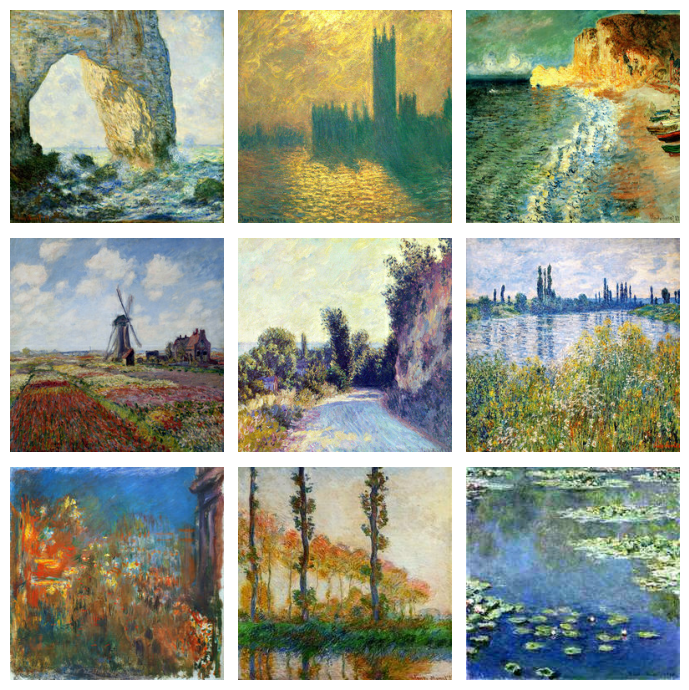

In [ ]:
present_sammples(next(iter(monet_data.batch(9))))

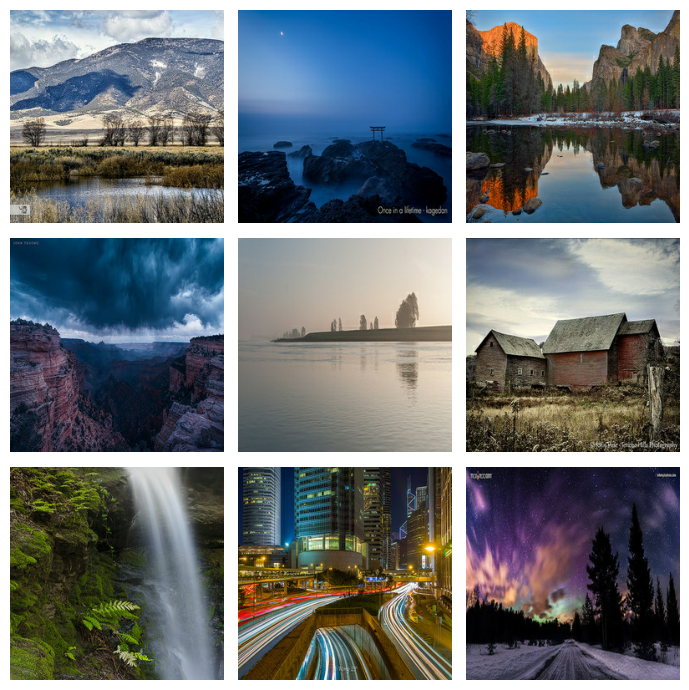

In [ ]:
present_sammples(next(iter(photos_data.batch(9))))

###Presenting The Color Channels

In [ ]:
#function for creating and displaying a histogram for each image sample
def display_image_channels(file_path, num_samples=1, title=''):
  files_names = os.listdir(file_path)
  chosen_file_names = np.random.choice(files_names, size=num_samples)

  fig, axes = plt.subplots(2*num_samples, 4, figsize=(20, 8*num_samples))

  for i, fileName in enumerate(chosen_file_names):
    sample_image_path = os.path.join(file_path, fileName)
    decodedImage = cv2.imread(sample_image_path)
    decodedImage = cv2.cvtColor(decodedImage, cv2.COLOR_BGR2RGB)

    axes[i*2][0].imshow(decodedImage)
    axes[i*2][0].axis("off")
    axes[i*2][0].set_title(f'{title} {i+1}', color="#3737ff")

    for j in range(3):
      #extract an array from individual color channels and convery to 1D Array
      image_channels = decodedImage[:, :, j].reshape(-1)
      axes[i*2][j+1].hist(image_channels, bins=256, color=['#ad2004', '#007446', '#13358f'][j], alpha=0.3)
      axes[i*2][j+1].set_title(f'{title} {i+1}', color='#3737ff')

      #Gray scale image
      axes[i*2+1][0].imshow(np.mean(decodedImage, axis=2), cmap='gray')
      axes[i*2+1][0].set_title(f'{title} {i+1}', color='#3737ff')

      #red, green, blue channels
      for k in range(3):
        image_chan = np.full_like(decodedImage, 0)
        image_chan[:, :, k] = decodedImage[:, :, k]
        axes[i*2+1][k+1].imshow(image_chan)
        axes[i*2+1][k+1].set_title(f'{title} {i+1}', color='#3737ff')

  plt.show()

####Displaying Monet Histogram with 2 samples

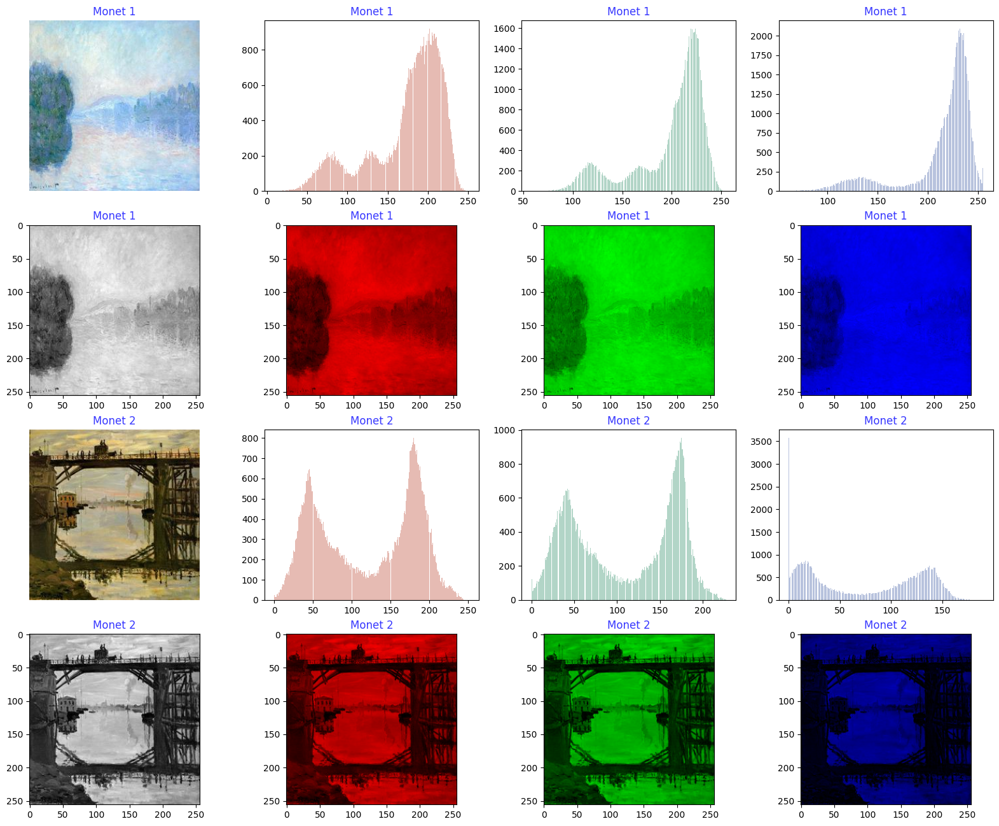

In [ ]:
display_image_channels(file_path='/content/monet_jpg', num_samples=2, title="Monet")

####Displaying Photo Histogram with 2 samples

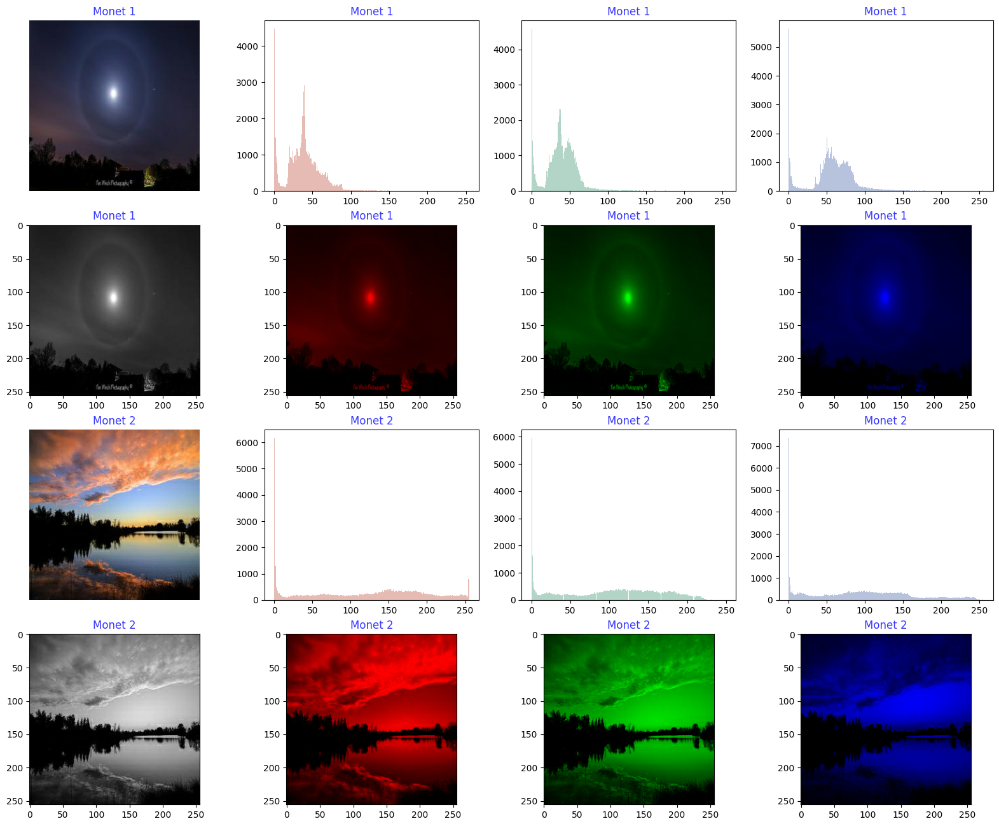

In [ ]:
display_image_channels(file_path='/content/photo_jpg', num_samples=2, title="Monet")

##Data Augmentation

Using Data augmentation for GANs should be done with more considerations.
If we apply transformations which will alter the style of the image too much(such as: brightness, contrast, saturation etc) it will cause our generator to unefficiently learn the style.
We will be using on spatial transformations (flips, rotates, crops etc)

###Rotation Augmentation

In [ ]:
def image_rotation(image):
  try:
    #Defining the rotation angles
    rotation_angles = tf.constant([0, 1, 2, 3], dtype=tf.int32) #0, 90, 180, 270 degrees (jumps of 90 deg)

    #choosing one rotation randomly
    shuffle = tf.random.shuffle(rotation_angles)
    rotation_angle = shuffle[0]

    #Rotate with the chosen angle
    image = tf.image.rot90(image, k=rotation_angle)
  except Exception as e:
    print("Error in image rotation:", e)
  return image

###Flip Augmentation

In [ ]:
def image_flip(image):
  try:
    return tf.image.random_flip_left_right(tf.image.random_flip_up_down(image))
  except Exception as e:
    print("Error in image flip:", e)
  return image

###Transpose Augmentation

In [ ]:
def image_transpose(image):
  try:
    return tf.image.transpose(image)
  except Exception as e:
    print("Error in image transpose:", e)
  return image

###Crop Augmentation

In [ ]:
def image_crop(image, height=256, width=256):
  try:
    return tf.image.random_crop(image, size=[height, width, 3])
  except Exception as e:
    print("Error in image crop:", e)
  return image

##Applying Augmentation

In [ ]:
def apply_aug(filenames, labeled=True, ordered=False, repeat=False, shuffle=False,
              rotation=False, flip=False, transpose=False, crop=False, height=256, width=256):
  dataset = tf.data.TFRecordDataset(filenames)
  dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTO)

  if repeat: #used for number of epochs
    dataset = dataset.repeat()
  if shuffle:
    dataset = dataset.shuffle(512)
  if rotation:
    dataset = dataset.map(image_rotation, num_parallel_calls=AUTO)
  if flip:
    dataset = dataset.map(image_flip, num_parallel_calls=AUTO)
  if transpose:
    dataset = dataset.map(image_transpose, num_parallel_calls=AUTO)
  if crop:
    crop_function = functools.partial(image_crop, height=height, width=width)
    dataset = dataset.map(crop_function, num_parallel_calls=AUTO)

  #When the GPU processes a batch, we will use the CPU to load the next batch ahead of use
  dataset = dataset.prefetch(AUTO)

  return dataset

####Loading the Data

In [ ]:
monetData = apply_aug(monet_files, labeled = True).batch(1)
photosData = apply_aug(photos_files, labeled = True).batch(1)

##Building the Generator

###Downsampling - Used for gathering features.

In [ ]:
def downsample(filters, size, stride = 2, padding = 'same', apply_instancenorm=True):
  #initializing weights to filters - creating random tensor of weights around the given
  #mean, with margins of standard deviation.
  init = tf.random_normal_initializer(0., 0.02)

  #initialzing instance normazilation - Initializing two different initializers for
  #future scaling and improving of the initializers
  inst_init = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)

  layer = keras.Sequential()
  layer.add(Conv2D(filters,
                   size,
                   strides = stride,
                   padding = padding,
                   kernel_initializer = init,
                   use_bias=False))

  if apply_instancenorm:
    #GroupNormalization with -1 = for calculating the mean and sd, we run over
    #the layers created by the filters (=channels).
    #for each channel we run over every pixel in that channel (=feature map) and calculate
    #accordingly. mean = μ(x, y, c) = (1 / W * H) * Σ( v(i, j, c) )
    #standard deviation = σ²(x, y, c) = (1 / W * H) * Σ( (v(i, j, c) - μ(x, y, c))^2 )
    layer.add(GroupNormalization(groups = -1, gamma_initializer = inst_init))
  layer.add(LeakyReLU()) #Using leaky for negative values
  return layer



###Upsampling - Using the features to reconstruct the image.

In [ ]:
def upsample(filters, size, stride = 2, padding = 'same', apply_dropout=False, dropout_rate = 0.5):
  init = tf.random_normal_initializer(0., 0.02)

  inst_init = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)

  layer = keras.Sequential()
  layer.add(Conv2DTranspose(filters,
                   size,
                   strides = stride,
                   padding = padding,
                   kernel_initializer = init,
                   use_bias=False))

  layer.add(GroupNormalization(groups = -1, gamma_initializer = inst_init))

  if apply_dropout:
    layer.add(Dropout(dropout_rate))

  layer.add(ReLU())

  return layer

###Generator

In [ ]:
def generator_builder(dropout_rate = 0.5, filter_size_L1 = 4, filters_size = 4, filters_L1 = 64, transfer_layers= 5, stride = 2, padding = 'same'):
  inputs = Input(shape=[256, 256, 3])

  # Encoder
  downsample_layers=[
      downsample(filters = filters_L1, size = filter_size_L1, stride = stride, padding = padding, apply_instancenorm=False), #IMG(128,128)
      downsample(filters = filters_L1*2, size = filters_size, stride = stride, padding = padding), #IMG(64,64)
      downsample(filters = filters_L1*2**2, size = filters_size, stride = stride, padding = padding), #IMG(32,32)
  ]

  downsample_layers += [
      downsample(filters = filters_L1*2**2, size = filters_size, stride = stride, padding = padding)
      for i in range(transfer_layers)
  ]
  # --------

  upsample_layers=[]

  upsample_layers += [
      upsample(filters = filters_L1*2**2, size = filters_size, stride = stride, padding = padding, apply_dropout = True, dropout_rate = dropout_rate)
      for i in range(transfer_layers - 1)
  ]

  upsample_layers.extend([
      upsample(filters = filters_L1*2**2, size = filters_size, stride = stride, padding = padding),
      upsample(filters = filters_L1*2**2, size = filters_size, stride = stride, padding = padding),
      upsample(filters = filters_L1*2, size = filters_size, stride = stride, padding = padding),
      upsample(filters = filters_L1, size = filters_size, stride = stride, padding = padding),
  ])

  final_init = tf.random_normal_initializer(0., 0.02)



  final_layer = Conv2DTranspose(3, filter_size_L1, strides=stride, padding=padding, activation='tanh')

  x = inputs
  skips = []
  for layer in downsample_layers:
    x = layer(x)
    skips.append(x)

  skips = reversed(skips[:-1])


  for layer, skip in zip(upsample_layers, skips):
    x = layer(x)
    x = Concatenate()([x, skip])

  x = final_layer(x)

  model = keras.Model(inputs=inputs, outputs=x)

  return model

###Running the Generators

Generators Summary

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3072      ['input_1[0][0]']             
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131328    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 256)          524800    ['sequential_1[0][0]']        
                                                                          

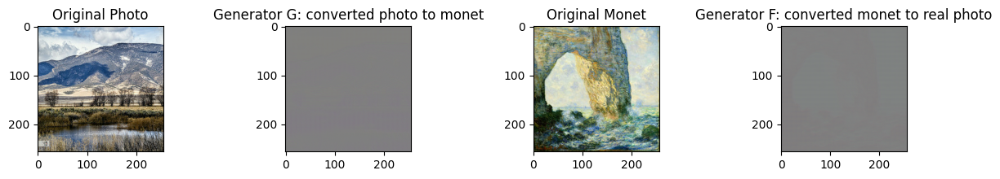

In [ ]:
with strategy.scope():
  monet_gen = generator_builder() #Default parameters

  photos_gen = generator_builder() #Default parameters

print('Generators Summary\n')
monet_gen.summary()

#applying the generators on the images
photoIter = next(iter(photosData))
photo2monet = monet_gen(photoIter)

monetIter = next(iter(monetData))
monet2photo = photos_gen(monetIter)

#Plotting the results of the two generators
plt.figure(figsize=(15, 2))
plt.subplot(1, 4, 1)
plt.title("Original Photo")
plt.imshow(photoIter[0] * 0.5 + 0.5)

plt.subplot(1, 4, 2)
plt.title("Generator G: converted photo to monet")
plt.imshow(photo2monet[0] * 0.5 + 0.5)


plt.subplot(1, 4, 3)
plt.title("Original Monet")
plt.imshow(monetIter[0] * 0.5 + 0.5)

plt.subplot(1, 4, 4)
plt.title("Generator F: converted monet to real photo")
plt.imshow(monet2photo[0] * 0.5 + 0.5)
plt.show()

##Building the Discriminator

In [ ]:
def discriminator_builder(filter_size = 4, filters_L1 = 64, downsample_layers_num=3, stride = 1):
  init = tf.random_normal_initializer(0, 0.02)
  inst_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

  input = Input(shape=[256, 256, 3], name='input_layer')
  x=input

  noise = GaussianNoise(0.001)(input)
  x = Concatenate()([x, noise])

  downsample_layers = []

  for i in range(downsample_layers_num):
    filters = filters_L1 * (2**i)
    if i==0:
      downsample_layers.append(downsample(filters, size=filter_size, apply_instancenorm=False))
    else:
      downsample_layers.append(downsample(filters, size=filter_size))

  for layer in downsample_layers:
    x = layer(x)

  padding = ZeroPadding2D()(x)
  convLayer = Conv2D(filters_L1 * (2** (downsample_layers_num)), filter_size, strides=stride, kernel_initializer=init, use_bias=False)(padding)
  normalize = GroupNormalization(groups=-1, gamma_initializer=inst_init)(convLayer)
  leaky_relu = LeakyReLU()(normalize)

  padding2 = ZeroPadding2D()(leaky_relu)
  finalLayer = Conv2D(1, filter_size, strides=1, kernel_initializer=init)(padding2)

  return keras.Model(inputs=input, outputs=finalLayer)

##Building The CycleGan

In [ ]:
class CycleGan(keras.Model): #The class will inherit from keras.Model
  def __init__(
      self,
      monet_gen,
      photos_gen,
      monet_dis,
      photos_dis,
      lambda_cycle=10,
      buffer_size=50
  ):
    super(CycleGan, self).__init__() #Initializes the superclass, keras.Model

    self.monetGen = monet_gen
    self.photosGen = photos_gen
    self.monetDis = monet_dis
    self.photosDis = photos_dis
    self.lambda_cycle = lambda_cycle
    self.buffer_size = buffer_size

  #defining the needed optimizers and loss functions for compiling the model
  def compile(
      self,
      monetOptimizer,
      photosOptimizer,
      mDisOptimizer,
      pDisOptimizer,
      genLossFunc,
      disLossFunc,
      cycleLossFunc,
      idLossFunc
  ):
    super(CycleGan, self).compile() #calling the compile method of keras.Model

    self.monetOptimizer = monetOptimizer
    self.photosOptimizer = photosOptimizer
    self.mDisOptimizer = mDisOptimizer
    self.pDisOptimizer = pDisOptimizer
    self.genLossFunc = genLossFunc
    self.disLossFunc = disLossFunc
    self.cycleLossFunc = cycleLossFunc
    self.idLossFunc = idLossFunc


  def train_step(self, batch_data):
    real_monet, real_photos = batch_data

    #We will be using GradientTape which allows to compute the gradients during our training and to be used
    #in the backpropagation process.
    with GradientTape(persistent = True) as tape:
      #---------------------------#
      #    Forward Propagation    #
      #---------------------------#

      #------------ Generators G and F generating the images -----------#
      #generates fake monet images and cycle the fake results back to regular photo
      fakeMonet = self.monetGen(real_photos, training = True)
      cycledPhotos = self.photosGen(fakeMonet, training = True)

      #generate fake phots from monet pictures and cycle the fake results back to monet
      fakePhotos = self.photosGen(real_monet, training = True)
      cycledMonet = self.monetGen(fakeMonet, training = True)

      #generate identity outputs (monet to monet, photo to photo)
      idMonet = self.monetGen(real_monet, training = True)
      idPhotos = self.photosGen(real_photos, training = True)

      #--------------------------#
      #      Discriminator       #
      #--------------------------#

      #send real images to discriminator for training
      disRealMonet = self.monetDis(real_monet, training = True)
      disRealPhotos = self.photosDis(real_photos, training = True)

      #send fake images to discriminator
      disFakeMonet = self.monetDis(fakeMonet, training = True)
      disFakePhotos = self.photosDis(fakePhotos, training = True)

      #-------------------------#
      #    Back Propagation     #
      #-------------------------#

      #------- Loss Function --------#
      #We want the generators to send fake images to the corresponding discriminator and think they are real
      #Giving the loss function what the discriminator thought about the photo given to it.
      monetGenLoss = self.genLossFunc(disFakeMonet)
      photosGenLoss = self.genLossFunc(disFakePhotos)

      #Checking if the cycled photos looks like their original.
      cycleLoss = self.cycleLossFunc(real_monet, cycledMonet, self.lambda_cycle) + self.cycleLossFunc(real_photos, cycledPhotos, self.lambda_cycle)

      #loss of the generators with the identity
      totalMonetGenLoss = monetGenLoss + cycleLoss + self.idLossFunc(real_monet, idMonet, self.lambda_cycle)
      totalPhotosGenLoss = photosGenLoss + cycleLoss + self.idLossFunc(real_photos, idPhotos, self.lambda_cycle)

      #Loss of the discriminators
      monetDisLoss = self.disLossFunc(disRealMonet, disFakeMonet)
      photosDisLoss = self.disLossFunc(disRealPhotos, disFakePhotos)

    #updating generator gradient
    monetGenGradients = tape.gradient(totalMonetGenLoss, self.monetGen.trainable_variables)
    photosGenGradients = tape.gradient(totalPhotosGenLoss, self.photosGen.trainable_variables)

    #updating discriminator gradient
    monetDisGradients = tape.gradient(monetDisLoss, self.monetDis.trainable_variables)
    photosDisGradients = tape.gradient(photosDisLoss, self.photosDis.trainable_variables)

    #Updating the parameters of generators and discriminators
    self.monetOptimizer.apply_gradients(zip(monetGenGradients, self.monetGen.trainable_variables))
    self.photosOptimizer.apply_gradients(zip(photosGenGradients, self.photosGen.trainable_variables))

    self.mDisOptimizer.apply_gradients(zip(monetDisGradients, self.monetDis.trainable_variables))
    self.mDisOptimizer.apply_gradients(zip(photosDisGradients, self.photosDis.trainable_variables))


    return {
        'monetGenLoss': totalMonetGenLoss,
        'photosGenLoss': totalPhotosGenLoss,
        'monetDisLoss': monetDisLoss,
        'photosDisLoss': photosDisLoss,
        'cycleLoss': cycleLoss,
    }



###Loss Functions

In [ ]:
with strategy.scope():
  def discriminator_loss(real, fake):
    real_loss = keras.losses.BinaryCrossentropy(from_logits=True, reduction=keras.losses.Reduction.NONE)(tf.ones_like(real), real)

    generated_loss = keras.losses.BinaryCrossentropy(from_logits=True, reduction=keras.losses.Reduction.NONE)(tf.zeros_like(fake), fake)

    totalDisLoss = real_loss + generated_loss

    return totalDisLoss * 0.5 #Return the average sum of totalDisLoss

with strategy.scope():
  def generator_loss(fake):
    return keras.losses.BinaryCrossentropy(from_logits=True, reduction=keras.losses.Reduction.NONE)(tf.ones_like(fake), fake)


with strategy.scope():
  def cycle_loss(real_image, cycled_image, Lambda):
    loss = tf.reduce_mean(tf.abs(real_image - cycled_image)) #The difference between the real image and the cycled real image will give us the differences

    return Lambda * loss

with strategy.scope():
  def identity_loss(real_image, id_image, Lambda):
    loss = tf.reduce_mean(real_image - id_image)

    return Lambda * loss * 0.5





##Helper Function

In [ ]:
# plot adversary, cycle losses
def plotting(history):
    # Calculate mean losses
    mean_monetGen_loss = np.mean(history['monetGenLoss'], axis=(1, 2, 3))
    mean_photosGenLoss = np.mean(history['photosGenLoss'], axis=(1, 2, 3))
    mean_monetDisLoss = np.mean(history['monetDisLoss'], axis=(1, 2, 3))
    mean_photosDisLoss = np.mean(history['photosDisLoss'], axis=(1, 2, 3))


    # Plotting the losses
    epochs = range(1, len(mean_monetGen_loss) + 1)

    plt.figure(figsize=(12, 5))
    plt.plot(epochs, mean_monetGen_loss, 'b', label='Monet Gen Loss')
    plt.plot(epochs, mean_photosGenLoss, 'r', label='Photo Gen Loss')
    plt.plot(epochs, mean_monetDisLoss, 'g', label='Monet Disc Loss')
    plt.plot(epochs, mean_photosDisLoss, 'y', label='Photo Disc Loss')
    plt.plot(epochs, history['cycleLoss'], 'm', label='Cycle Loss')  # Added total cycle loss
    plt.title('CycleGAN Training Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Mean Loss')
    plt.legend(loc='upper right')
    plt.show()

# Plot generated Monet-style photos
def visualizing(photos_data, monet_generator, photo_generator, num_images=5):
    fig, ax = plt.subplots( num_images, 3, figsize=(12*3, 12*num_images))
    fake_monet_features = []
    real_monet_features = []

    #for i, photo in enumerate(photo_data.take(num_images)):
    total_images = len(list(photos_data))
    random_indices = random.sample(range(total_images), num_images)

    for i, idx in enumerate(random_indices):
        photo = next(iter(photos_data.skip(idx).take(1)))
        photo_monet = monet_generator(photo, training=False)
        cycle_photo = photo_generator(photo_monet, training=False)
        photo_monet = photo_monet[0].numpy()
        photo_monet = (photo_monet * 127.5 + 127.5).astype(np.uint8)
        cycle_photo = cycle_photo[0].numpy()
        cycle_photo = (cycle_photo * 127.5 + 127.5).astype(np.uint8)
        photo = (photo[0] * 127.5 + 127.5).numpy().astype(np.uint8)


        ax[i, 0].imshow(photo)
        ax[i, 1].imshow(photo_monet)
        ax[i, 2].imshow(cycle_photo)

        ax[i, 0].set_title("Input Photo")
        ax[i, 1].set_title("Monet-style Photo")
        ax[i, 2].set_title("Cycled Photo")
        ax[i, 0].axis("off")
        ax[i, 1].axis("off")
        ax[i, 2].axis("off")

    plt.show()

##Training 1 - Base Model

Parameters

In [ ]:
EPOCHS = 5
BATCH_SIZE= 1
NUM_MONET_PHOTOS = 300 #we got this from part 1 of this notebook. No need to change
LEARNING_RATE = 0.0001
BETA_1 = 0.8
LAMBDA = 10
BUFFER_SIZE = 50
DROPOUT_RATE_GEN = 0
TRANSFER_LAYERS_GEN = 3
STRIDE_NUM_GEN, STRIDE_NUM_DIS = 2,1
PADDING_GEN ='same'
FILTER_SIZE_GEN, FILTER_SIZE_DIS = 2, 2
FILTER_SIZE_L1_GEN = 2
FILTER_L1_GEN ,FILTER_L1_DIS = 32,32
DOWNSAMPLE_LAYER_NUM_DIS= 2

Building the generators and discriminators

In [ ]:
with strategy.scope():
  #----------------#
  #   Generators   #
  #----------------#

  monet_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  photos_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  #------------------#
  #  Discriminators  #
  #------------------#

  monet_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  photos_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  #----------------#
  #   Optimizers   #
  #----------------#

  monetGen_optimizer = keras.optimizers.legacy.SGD(learning_rate=LEARNING_RATE, momentum=BETA_1)

  photosGen_optimizer = keras.optimizers.legacy.SGD(learning_rate=LEARNING_RATE, momentum=BETA_1)

  monetDis_optimizer = keras.optimizers.legacy.SGD(learning_rate=LEARNING_RATE, momentum=BETA_1)

  photosDis_optimizer = keras.optimizers.legacy.SGD(learning_rate=LEARNING_RATE, momentum=BETA_1)


Creating the CycleGan instance

In [ ]:
with strategy.scope():
  cycleGan = CycleGan(
      monet_generator, photos_generator, monet_discriminator, photos_discriminator, lambda_cycle=LAMBDA, buffer_size=BUFFER_SIZE
  )

  cycleGan.compile(
        monetOptimizer = monetGen_optimizer,
        photosOptimizer = photosGen_optimizer,
        mDisOptimizer = monetDis_optimizer,
        pDisOptimizer = photosDis_optimizer,
        genLossFunc = generator_loss,
        disLossFunc = discriminator_loss,
        cycleLossFunc = cycle_loss,
        idLossFunc = identity_loss
  )

In [ ]:
monet_generator.summary()

photos_discriminator.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential_32 (Sequential)  (None, 128, 128, 32)         384       ['input_3[0][0]']             
                                                                                                  
 sequential_33 (Sequential)  (None, 64, 64, 64)           8320      ['sequential_32[0][0]']       
                                                                                                  
 sequential_34 (Sequential)  (None, 32, 32, 128)          33024     ['sequential_33[0][0]']       
                                                                                            

###Training


In [ ]:
history = cycleGan.fit(
    tf.data.Dataset.zip((monetData, photosData)),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
)

Epoch 1/5
300/300 [==============================] - 102s 81ms/step - monetGenLoss: 18.0187 - photosGenLoss: 15.7185 - monetDisLoss: 0.4880 - photosDisLoss: 0.6861 - cycleLoss: 20.3091
Epoch 2/5
300/300 [==============================] - 24s 80ms/step - monetGenLoss: 21.6480 - photosGenLoss: 18.8932 - monetDisLoss: 0.2411 - photosDisLoss: 0.7433 - cycleLoss: 21.3117
Epoch 3/5
300/300 [==============================] - 24s 80ms/step - monetGenLoss: 22.7250 - photosGenLoss: 17.7759 - monetDisLoss: 0.3618 - photosDisLoss: 0.6071 - cycleLoss: 20.5651
Epoch 4/5
300/300 [==============================] - 24s 81ms/step - monetGenLoss: 22.8642 - photosGenLoss: 21.0891 - monetDisLoss: 0.0889 - photosDisLoss: 0.4654 - cycleLoss: 18.9568
Epoch 5/5
300/300 [==============================] - 25s 82ms/step - monetGenLoss: 24.6831 - photosGenLoss: 24.3264 - monetDisLoss: 0.0755 - photosDisLoss: 0.1873 - cycleLoss: 20.2761


Plot the loss

In [ ]:
print("Monet Generator Loss shape:", np.array(history.history['monetGenLoss']).shape)
print("Monet Discriminator Loss shape:", np.array(history.history['monetDisLoss']).shape)
print("Monet total cycle Loss:", history.history['cycleLoss'])

Monet Generator Loss shape: (5, 1, 66, 66)
Monet Discriminator Loss shape: (5, 1, 66, 66)
Monet total cycle Loss: [21.445106506347656, 20.68849754333496, 19.635177612304688, 20.003320693969727, 20.440160751342773]


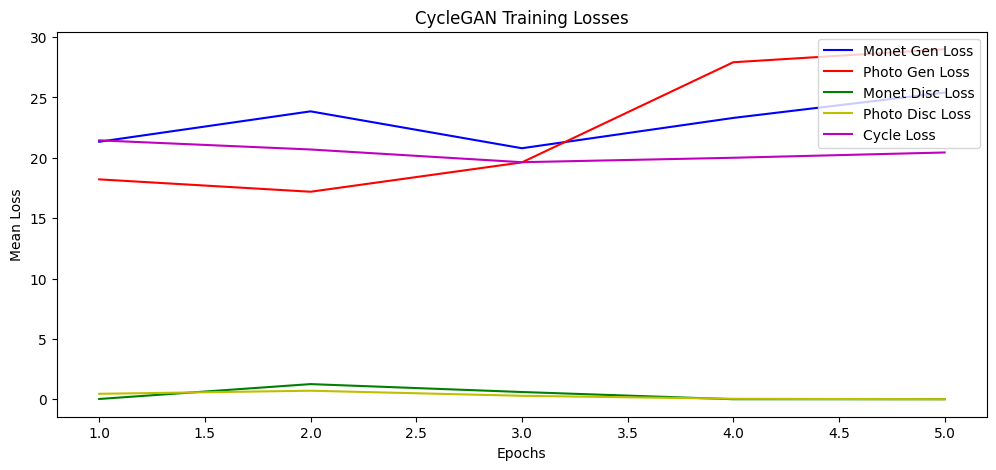

In [ ]:
plotting(history.history)

###Visualization Result

Displaying the images as a cycle:
Original | Monet | Cycled back to Original

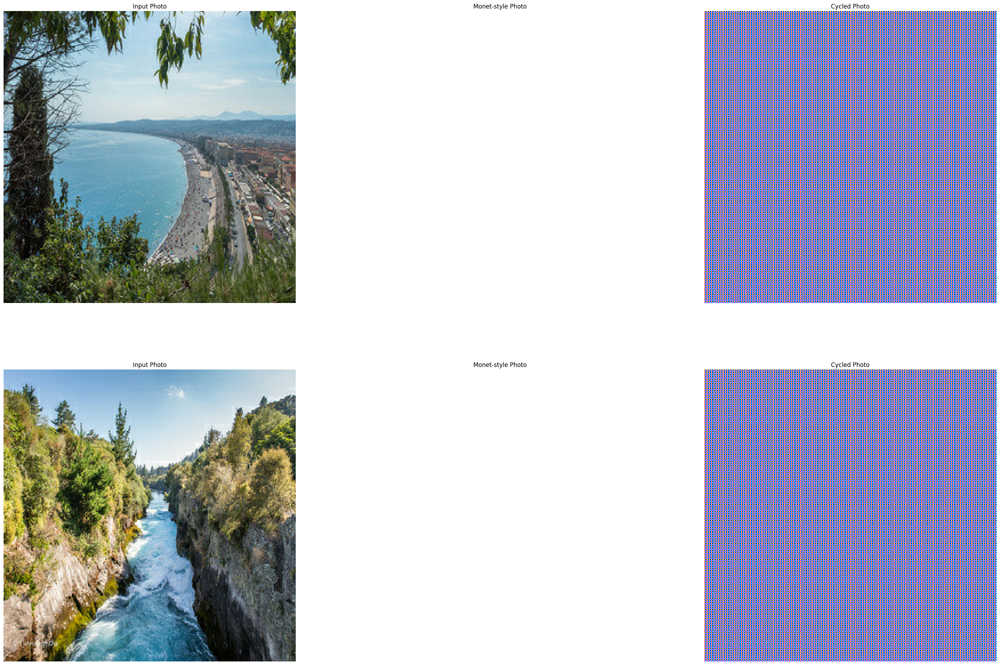

In [ ]:
visualizing(photosData, monet_generator, photos_generator, num_images=2)

##Training 2 - Tuned Parameters

Parameters

In [ ]:
EPOCHS = 5
BATCH_SIZE= 2
NUM_MONET_PHOTOS = 300
LEARNING_RATE = 0.0003
BETA_1 = 0.6
LAMBDA = 3
BUFFER_SIZE = 50
DROPOUT_RATE_GEN = 0.5
TRANSFER_LAYERS_GEN = 5
STRIDE_NUM_GEN, STRIDE_NUM_DIS = 2,1
PADDING_GEN ='same'
FILTER_SIZE_GEN, FILTER_SIZE_DIS = 4, 4
FILTER_SIZE_L1_GEN = 4
FILTER_L1_GEN ,FILTER_L1_DIS = 64,64
DOWNSAMPLE_LAYER_NUM_DIS= 3

Building the generators and discriminators

In [ ]:
with strategy.scope():
  #----------------#
  #   Generators   #
  #----------------#

  monet_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  photos_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  #------------------#
  #  Discriminators  #
  #------------------#

  monet_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  photos_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  #----------------#
  #   Optimizers   #
  #----------------#

  monetGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  photosGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  monetDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  photosDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)


Creating the CycleGan instance

In [ ]:
with strategy.scope():
  cycleGan = CycleGan(
      monet_generator, photos_generator, monet_discriminator, photos_discriminator, lambda_cycle=LAMBDA, buffer_size=BUFFER_SIZE
  )

  cycleGan.compile(
        monetOptimizer = monetGen_optimizer,
        photosOptimizer = photosGen_optimizer,
        mDisOptimizer = monetDis_optimizer,
        pDisOptimizer = photosDis_optimizer,
        genLossFunc = generator_loss,
        disLossFunc = discriminator_loss,
        cycleLossFunc = cycle_loss,
        idLossFunc = identity_loss
  )

In [ ]:
monet_generator.summary()

photos_discriminator.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential_60 (Sequential)  (None, 128, 128, 64)         3072      ['input_5[0][0]']             
                                                                                                  
 sequential_61 (Sequential)  (None, 64, 64, 128)          131328    ['sequential_60[0][0]']       
                                                                                                  
 sequential_62 (Sequential)  (None, 32, 32, 256)          524800    ['sequential_61[0][0]']       
                                                                                            

###Training


In [ ]:
history = cycleGan.fit(
    tf.data.Dataset.zip((monetData, photosData)),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
)

Epoch 1/5
300/300 [==============================] - 199s 157ms/step - monetGenLoss: 2.5871 - photosGenLoss: 1.7798 - monetDisLoss: 0.5424 - photosDisLoss: 0.5690 - cycleLoss: 1.9462
Epoch 2/5
300/300 [==============================] - 47s 157ms/step - monetGenLoss: 2.6388 - photosGenLoss: 1.8084 - monetDisLoss: 0.5512 - photosDisLoss: 0.5258 - cycleLoss: 1.7414
Epoch 3/5
300/300 [==============================] - 47s 157ms/step - monetGenLoss: 2.4915 - photosGenLoss: 1.6318 - monetDisLoss: 0.6085 - photosDisLoss: 0.6091 - cycleLoss: 1.6623
Epoch 4/5
300/300 [==============================] - 47s 157ms/step - monetGenLoss: 2.4216 - photosGenLoss: 1.5497 - monetDisLoss: 0.6096 - photosDisLoss: 0.6169 - cycleLoss: 1.6411
Epoch 5/5
300/300 [==============================] - 47s 157ms/step - monetGenLoss: 2.3860 - photosGenLoss: 1.5086 - monetDisLoss: 0.6084 - photosDisLoss: 0.6186 - cycleLoss: 1.6404


Plot the loss

In [ ]:
print("Monet Generator Loss shape:", np.array(history.history['monetGenLoss']).shape)
print("Monet Discriminator Loss shape:", np.array(history.history['monetDisLoss']).shape)
print("Monet total cycle Loss:", history.history['cycleLoss'])

Monet Generator Loss shape: (5, 1, 30, 30)
Monet Discriminator Loss shape: (5, 1, 30, 30)
Monet total cycle Loss: [1.5955381393432617, 1.3585726022720337, 1.2600017786026, 1.3090076446533203, 1.3322392702102661]


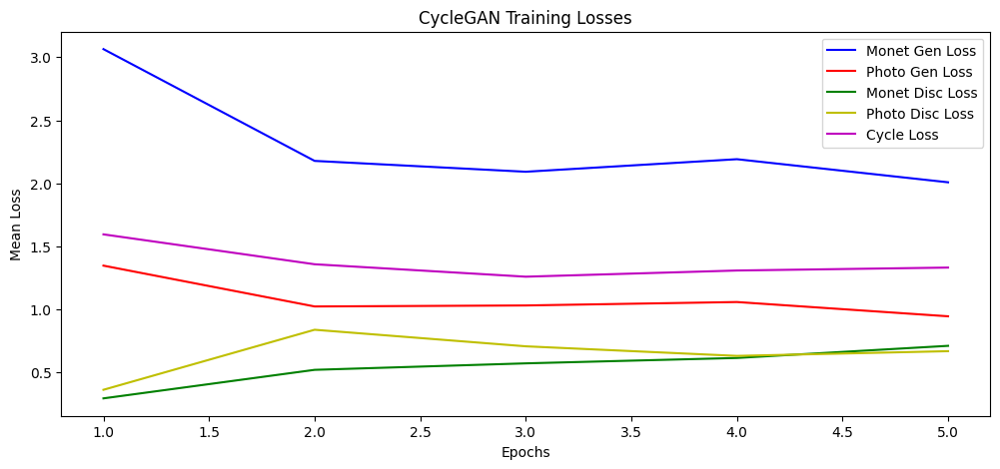

In [ ]:
plotting(history.history)

###Visualization Result

Displaying the images as a cycle:
Original | Monet | Cycled back to Original

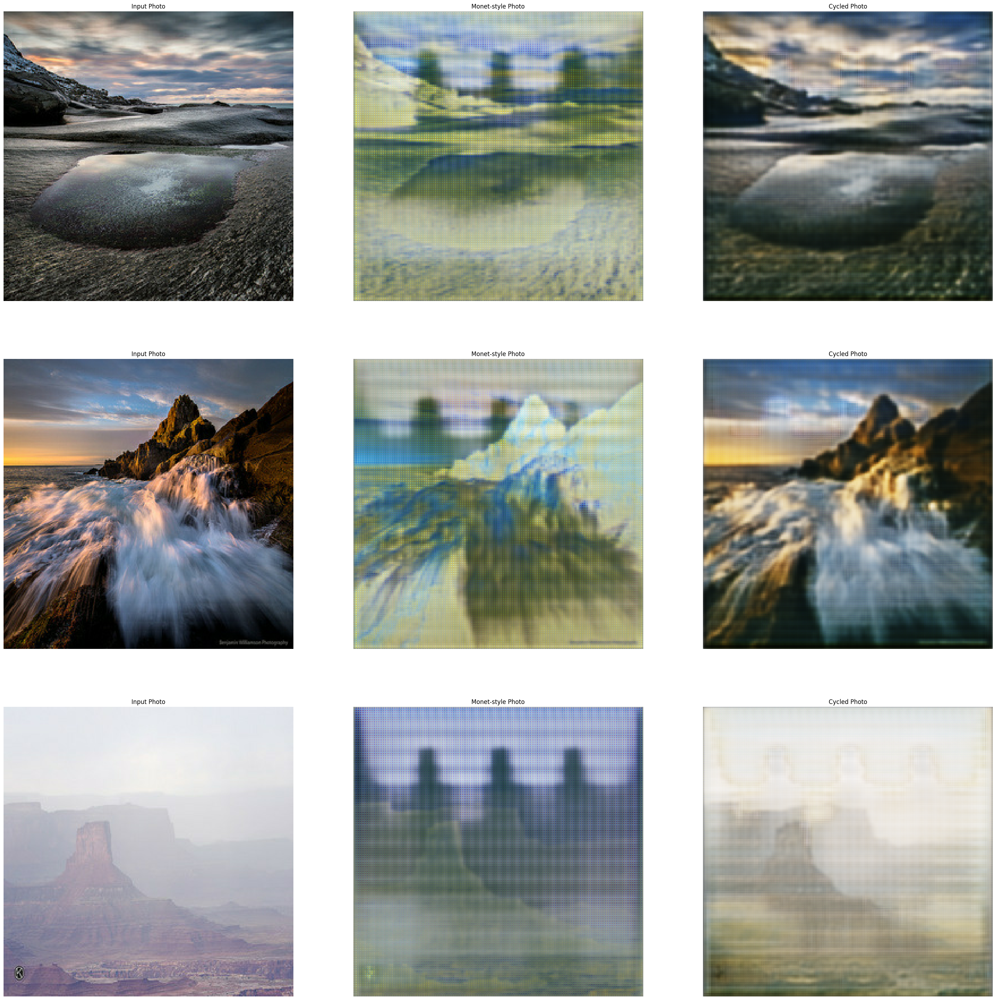

In [ ]:
visualizing(photosData, monet_generator, photos_generator, num_images=3)

##Training 3 - Adding Image Augmentation

Parameters

In [ ]:
EPOCHS = 5
BATCH_SIZE= 2
LEARNING_RATE = 0.0003
BUFFER_SIZE = 50
BETA_1 = 0.5
LAMBDA = 3
NUM_MONET_PHOTOS = 300*2

DROPOUT_RATE_GEN = 0.5
TRANSFER_LAYERS_GEN = 5
STRIDE_NUM_GEN, STRIDE_NUM_DIS = 2,1
PADDING_GEN ='same'
FILTER_SIZE_GEN, FILTER_SIZE_DIS = 4, 4
FILTER_SIZE_L1_GEN = 4
FILTER_L1_GEN ,FILTER_L1_DIS = 64,64
DOWNSAMPLE_LAYER_NUM_DIS= 3

In [ ]:
monetData_aug = apply_aug(monet_files, labeled = True, ordered=False, repeat=True, shuffle=True, rotation=True, flip=True, transpose=True, crop=False, height=256, width=256).batch(BATCH_SIZE)

photosData_aug = apply_aug(photos_files, labeled = True, ordered=False, repeat=False, shuffle=True, rotation=True, flip=True, transpose=True, crop=False, height=256, width=256).batch(BATCH_SIZE)

Building the generators and discriminators

In [ ]:
with strategy.scope():
  #----------------#
  #   Generators   #
  #----------------#

  monet_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  photos_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  #------------------#
  #  Discriminators  #
  #------------------#

  monet_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  photos_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  #----------------#
  #   Optimizers   #
  #----------------#

  monetGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  photosGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  monetDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)

  photosDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1)


Creating the CycleGan instance

In [ ]:
with strategy.scope():
  cycleGan = CycleGan(
      monet_generator, photos_generator, monet_discriminator, photos_discriminator, lambda_cycle=LAMBDA, buffer_size=BUFFER_SIZE
  )

  cycleGan.compile(
        monetOptimizer = monetGen_optimizer,
        photosOptimizer = photosGen_optimizer,
        mDisOptimizer = monetDis_optimizer,
        pDisOptimizer = photosDis_optimizer,
        genLossFunc = generator_loss,
        disLossFunc = discriminator_loss,
        cycleLossFunc = cycle_loss,
        idLossFunc = identity_loss
  )

In [ ]:
monet_generator.summary()

photos_discriminator.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential_98 (Sequential)  (None, 128, 128, 64)         3072      ['input_7[0][0]']             
                                                                                                  
 sequential_99 (Sequential)  (None, 64, 64, 128)          131328    ['sequential_98[0][0]']       
                                                                                                  
 sequential_100 (Sequential  (None, 32, 32, 256)          524800    ['sequential_99[0][0]']       
 )                                                                                         

###Training


In [ ]:
history2 = cycleGan.fit(
    tf.data.Dataset.zip((monetData_aug, photosData_aug)),
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    steps_per_epoch=300,
)

Epoch 1/5
300/300 [==============================] - 198s 157ms/step - monetGenLoss: 2.7936 - photosGenLoss: 1.8594 - monetDisLoss: 0.4887 - photosDisLoss: 0.5532 - cycleLoss: 2.0123
Epoch 2/5
300/300 [==============================] - 47s 156ms/step - monetGenLoss: 2.5887 - photosGenLoss: 1.7675 - monetDisLoss: 0.6059 - photosDisLoss: 0.6181 - cycleLoss: 1.7150
Epoch 3/5
300/300 [==============================] - 47s 157ms/step - monetGenLoss: 2.6289 - photosGenLoss: 1.7423 - monetDisLoss: 0.5840 - photosDisLoss: 0.6223 - cycleLoss: 1.7279
Epoch 4/5
300/300 [==============================] - 47s 156ms/step - monetGenLoss: 2.5314 - photosGenLoss: 1.5776 - monetDisLoss: 0.6026 - photosDisLoss: 0.6022 - cycleLoss: 1.6915
Epoch 5/5
300/300 [==============================] - 47s 156ms/step - monetGenLoss: 2.5472 - photosGenLoss: 1.7338 - monetDisLoss: 0.6051 - photosDisLoss: 0.6228 - cycleLoss: 1.7036


Plot the loss

In [ ]:
print("Monet Generator Loss shape:", np.array(history.history['monetGenLoss']).shape)
print("Monet Discriminator Loss shape:", np.array(history.history['monetDisLoss']).shape)
print("Monet total cycle Loss:", history.history['cycleLoss'])

Monet Generator Loss shape: (5, 1, 30, 30)
Monet Discriminator Loss shape: (5, 1, 30, 30)
Monet total cycle Loss: [1.5955381393432617, 1.3585726022720337, 1.2600017786026, 1.3090076446533203, 1.3322392702102661]


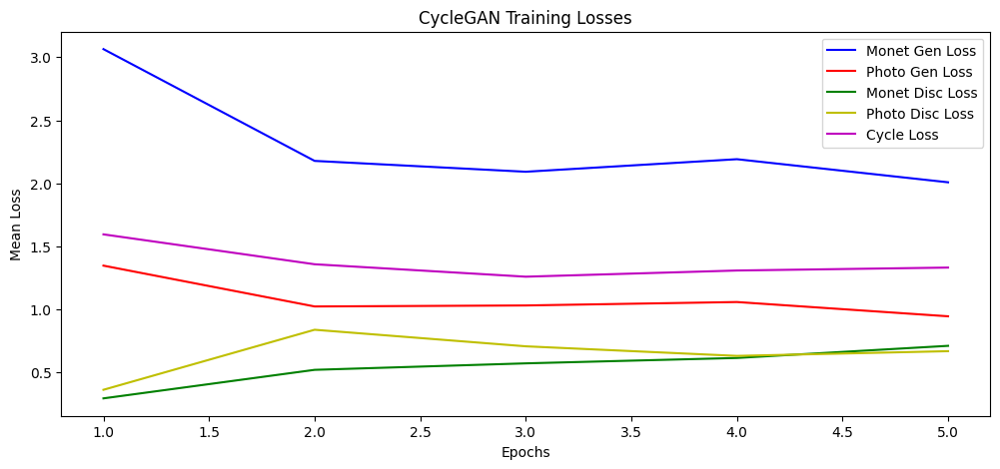

In [ ]:
plotting(history.history)

###Visualization Result

Displaying the images as a cycle:
Original | Monet | Cycled back to Original

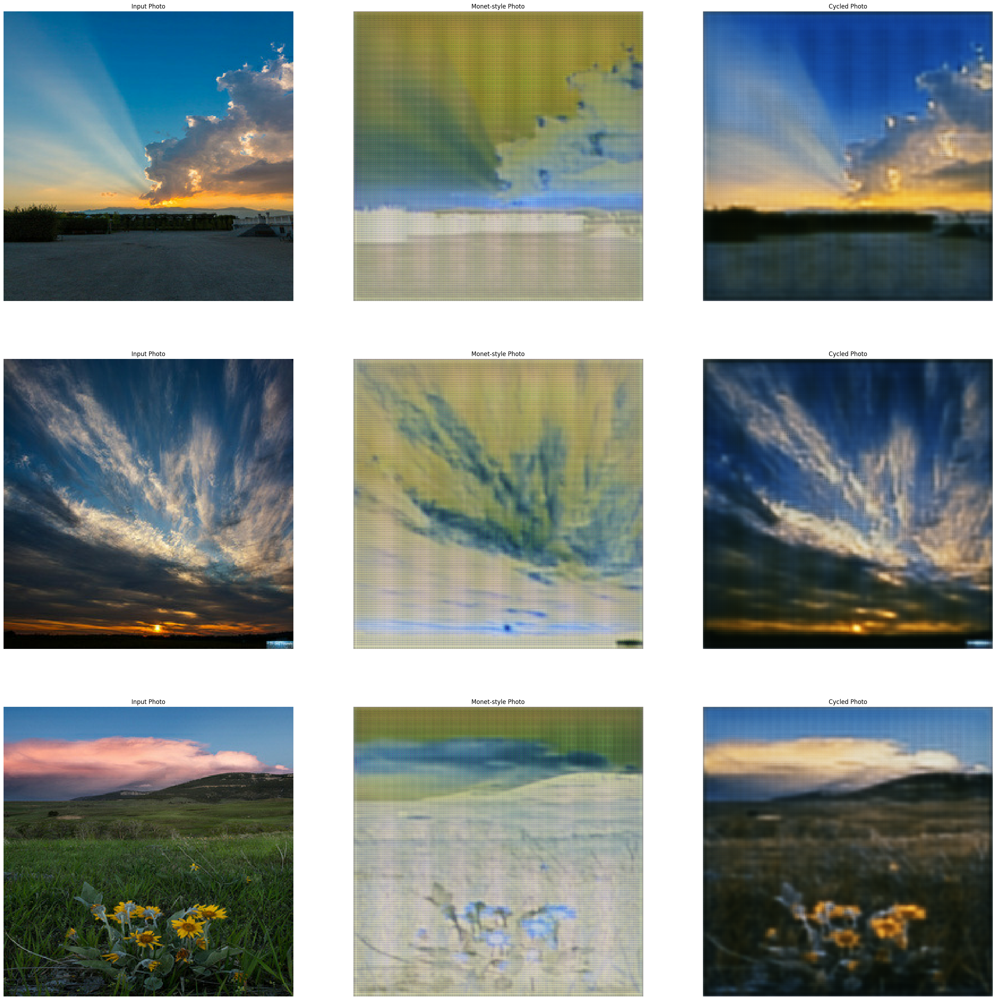

In [ ]:
visualizing(photosData, monet_generator, photos_generator, num_images=3)

##Training 4 - Adding Image Augmentations and Rate Scheduler

Parameters

In [ ]:
EPOCHS = 20
BATCH_SIZE= 9
NUM_MONET_PHOTOS = 300*2
NUM_PHOTOS = 7038
LEARNING_RATE = 3e-4
MIN_LEARNING_RATE = 1e-5
DECAY_STEPS = int(NUM_PHOTOS / BATCH_SIZE) * 5
DECAY_RATE = 0.6

BETA_1 = 0.5
LAMBDA = 3
BUFFER_SIZE = 50

DROPOUT_RATE_GEN = 0.5
TRANSFER_LAYERS_GEN = 5
STRIDE_NUM_GEN, STRIDE_NUM_DIS = 2,1
PADDING_GEN ='same'
FILTER_SIZE_GEN, FILTER_SIZE_DIS = 4, 4
FILTER_SIZE_L1_GEN = 4
FILTER_L1_GEN ,FILTER_L1_DIS = 64,64
DOWNSAMPLE_LAYER_NUM_DIS= 3

###Building a learning rate scheduler

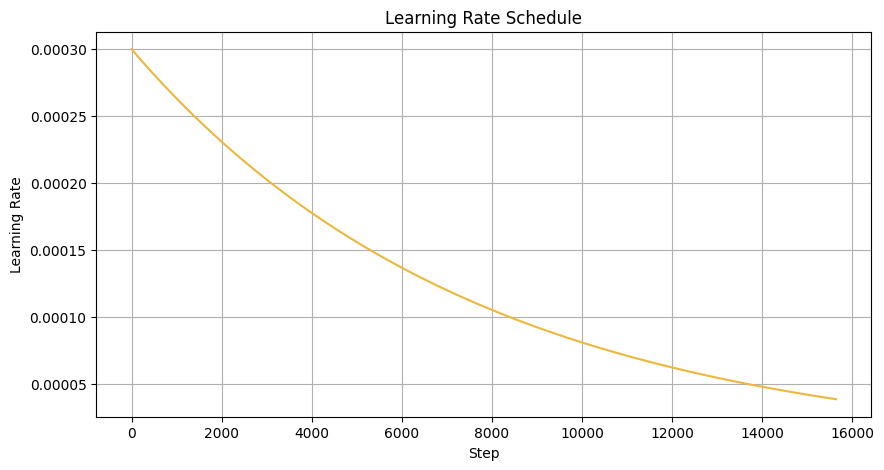

In [ ]:
class Scheduler(keras.optimizers.schedules.LearningRateSchedule):
  def __init__(
      self,
      init_lr,
      min_lr,
      decay_steps,
      decay_rate,
    ):
    super(Scheduler, self).__init__()

    self.init_lr = init_lr
    self.min_lr = min_lr
    self.decay_steps = decay_steps
    self.decay_rate = decay_rate

  def __call__(self, step):
    learningRate = tf.math.maximum(self.init_lr * self.decay_rate ** (step / self.decay_steps), self.min_lr)
    return learningRate

#Creating an instance of the class
scheduler = Scheduler(init_lr=LEARNING_RATE, min_lr=MIN_LEARNING_RATE, decay_steps=DECAY_STEPS, decay_rate=DECAY_RATE)

#plot the result
stepsNum = int(NUM_PHOTOS / BATCH_SIZE * EPOCHS)
lrs = [scheduler(tf.constant(step, dtype=tf.float32)).numpy() for step in range(stepsNum)]

plt.figure(figsize=(10,5))
plt.plot(range(stepsNum), lrs, color='#ebb73d')
plt.xlabel('Step')
plt.ylabel('Learning Rate')
plt.title('Learning Rate Schedule')
plt.grid(True)
plt.show()

###Loading Augmented data

In [ ]:
monetData_aug = apply_aug(monet_files, labeled = True, ordered=False, repeat=True, shuffle=True, rotation=True, flip=True, transpose=True, crop=False, height=256, width=256).batch(BATCH_SIZE)

photosData_aug = apply_aug(photos_files, labeled = True, ordered=False, repeat=False, shuffle=True, rotation=True, flip=True, transpose=True, crop=False, height=256, width=256).batch(BATCH_SIZE)

Building the generators and discriminators

In [ ]:
with strategy.scope():
  #----------------#
  #   Generators   #
  #----------------#

  monet_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  photos_generator = generator_builder(dropout_rate = DROPOUT_RATE_GEN, filter_size_L1 = FILTER_SIZE_L1_GEN, filters_size = FILTER_SIZE_GEN, filters_L1 = FILTER_L1_GEN,
                                      transfer_layers= TRANSFER_LAYERS_GEN, stride = STRIDE_NUM_GEN, padding = PADDING_GEN)

  #------------------#
  #  Discriminators  #
  #------------------#

  monet_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  photos_discriminator = discriminator_builder(filter_size = FILTER_SIZE_DIS, filters_L1 = FILTER_L1_DIS, downsample_layers_num=DOWNSAMPLE_LAYER_NUM_DIS, stride = STRIDE_NUM_DIS)

  #----------------#
  #   Optimizers   #
  #----------------#

  monetGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=scheduler, beta_1=BETA_1)

  photosGen_optimizer = keras.optimizers.legacy.Adam(learning_rate=scheduler, beta_1=BETA_1)

  monetDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=scheduler, beta_1=BETA_1)

  photosDis_optimizer = keras.optimizers.legacy.Adam(learning_rate=scheduler, beta_1=BETA_1)


Creating the CycleGan instance

In [ ]:
with strategy.scope():
  cycleGan = CycleGan(
      monet_generator, photos_generator, monet_discriminator, photos_discriminator, lambda_cycle=LAMBDA, buffer_size=BUFFER_SIZE
  )

  cycleGan.compile(
        monetOptimizer = monetGen_optimizer,
        photosOptimizer = photosGen_optimizer,
        mDisOptimizer = monetDis_optimizer,
        pDisOptimizer = photosDis_optimizer,
        genLossFunc = generator_loss,
        disLossFunc = discriminator_loss,
        cycleLossFunc = cycle_loss,
        idLossFunc = identity_loss
  )

In [ ]:
monet_generator.summary()

photos_discriminator.summary()

Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential_136 (Sequential  (None, 128, 128, 64)         3072      ['input_9[0][0]']             
 )                                                                                                
                                                                                                  
 sequential_137 (Sequential  (None, 64, 64, 128)          131328    ['sequential_136[0][0]']      
 )                                                                                                
                                                                                           

###Training


In [ ]:
history = cycleGan.fit(
    tf.data.Dataset.zip((monetData_aug, photosData_aug)),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
)

Epoch 1/20
782/782 [==============================] - 275s 157ms/step - monetGenLoss: 2.8421 - photosGenLoss: 1.9040 - monetDisLoss: 0.5156 - photosDisLoss: 0.5601 - cycleLoss: 1.8679
Epoch 2/20
782/782 [==============================] - 123s 157ms/step - monetGenLoss: 2.7505 - photosGenLoss: 1.8026 - monetDisLoss: 0.5680 - photosDisLoss: 0.6077 - cycleLoss: 1.7733
Epoch 3/20
782/782 [==============================] - 123s 158ms/step - monetGenLoss: 2.6531 - photosGenLoss: 1.5915 - monetDisLoss: 0.5557 - photosDisLoss: 0.6299 - cycleLoss: 1.7104
Epoch 4/20
782/782 [==============================] - 124s 158ms/step - monetGenLoss: 2.6369 - photosGenLoss: 1.3551 - monetDisLoss: 0.5494 - photosDisLoss: 0.6184 - cycleLoss: 1.6998
Epoch 5/20
782/782 [==============================] - 123s 157ms/step - monetGenLoss: 2.6066 - photosGenLoss: 1.1988 - monetDisLoss: 0.5524 - photosDisLoss: 0.5999 - cycleLoss: 1.7154
Epoch 6/20
782/782 [==============================] - 123s 157ms/step - monetGen

Plot the loss

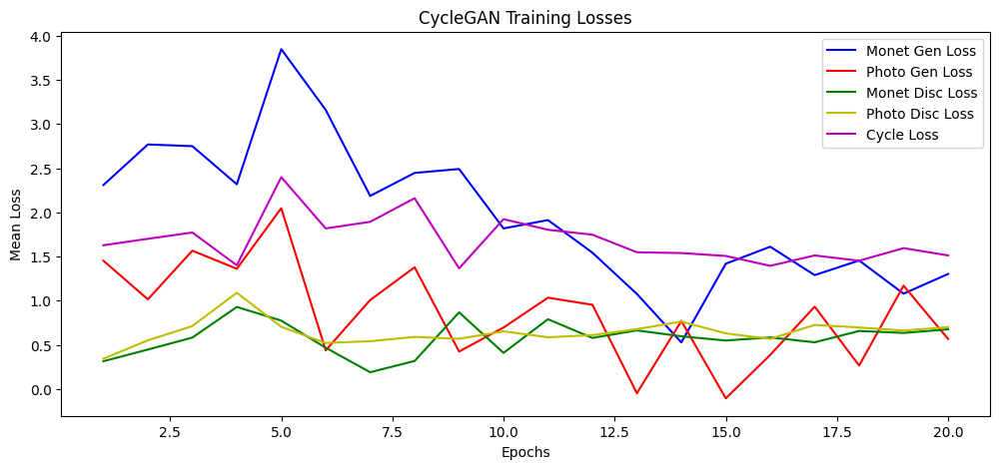

In [ ]:
plotting(history.history)

###Visualization Result

Displaying the images as a cycle:
Original | Monet | Cycled back to Original

In [ ]:
visualizing(photosData, monet_generator, photos_generator, num_images=20)

###Saving the weights

In [ ]:
# Save the weights
cycleGan.save('monet_cycleGan.keras')



/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_api.py:164: UserWarning: You are saving a model that has not yet been built. It might not contain any weights yet. Consider building the model first by calling it on some data.
  saving_lib.save_model(model, filepath)
/usr/local/lib/python3.10/dist-packages/keras/src/initializers/__init__.py:144: UserWarning: The `keras.initializers.serialize()` API should only be used for objects of type `keras.initializers.Initializer`. Found an instance of type <class 'tensorflow.python.ops.init_ops_v2.RandomNormal'>, which may lead to improper serialization.
  warnings.warn(


##Test Environment